<a href="https://colab.research.google.com/github/rodrigourech/ivi/blob/main/notebooks/LO1_Performance.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [20]:
import pandas as pd


# URLs using correct case-sensitive filenames
url_rcp45 = "https://raw.githubusercontent.com/rodrigourech/ivi/main/data/RCP45_tas.csv"
url_rcp85 = "https://raw.githubusercontent.com/rodrigourech/ivi/main/data/RCP85_tas.csv"

# Load data
df_rcp45 = pd.read_csv(url_rcp45, parse_dates=["date"], encoding="utf-8-sig")
df_rcp85 = pd.read_csv(url_rcp85, parse_dates=["date"], encoding="utf-8-sig")

# Sample data
df_rcp45_small = df_rcp45.sample(n=3000, random_state=42).reset_index(drop=True)
df_rcp85_large = df_rcp85.sample(n=300000, random_state=42).reset_index(drop=True)

# Block 1: Matplotlib vs. Plotly Scatterplot

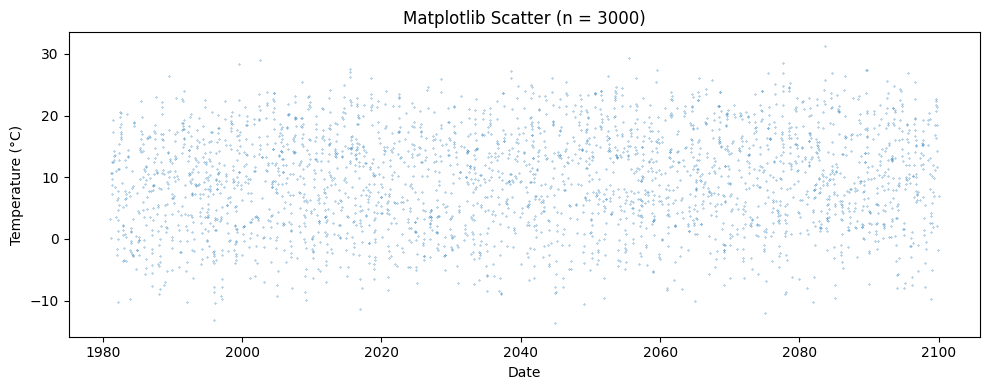

Matplotlib: 0.30411 seconds


Plotly: 0.12235 seconds


In [31]:
import matplotlib.pyplot as plt
import plotly.express as px
import time

# Matplotlib - Small
df = df_rcp45_small.copy()
start = time.time()
plt.figure(figsize=(10, 4))
plt.plot(df["date"], df["value"], linestyle="none", marker=".", markersize=0.5)
plt.title(f"Matplotlib Scatter (n = {len(df)})")
plt.xlabel("Date")
plt.ylabel("Temperature (°C)")
plt.tight_layout()
plt.show()
print("Matplotlib:", round(time.time() - start, 5), "seconds")


# Plotly - Small
df = df_rcp45_small.copy()
start = time.time()
fig = px.scatter(df, x="date", y="value", title=f"Plotly Scatter (n = {len(df)})")
fig.show()
print("Plotly:", round(time.time() - start, 5), "seconds")

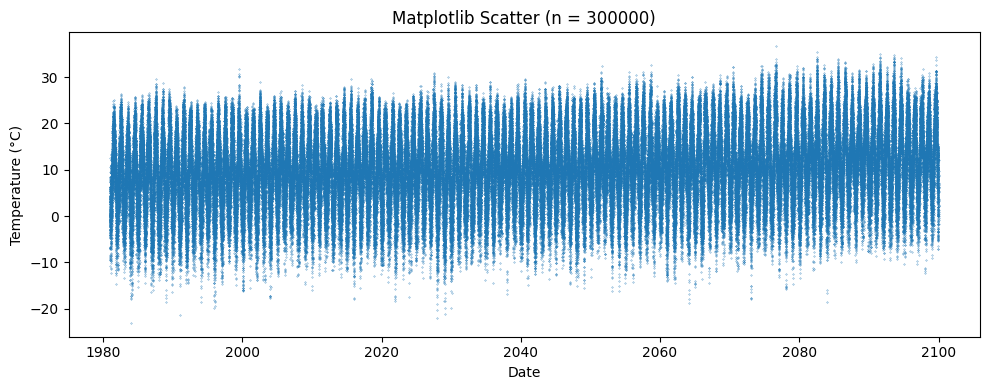

Matplotlib: 0.36615 seconds


Plotly: 2.72376 seconds


In [32]:
import matplotlib.pyplot as plt
import plotly.express as px
import time

# Matplotlib - Large
df = df_rcp85_large.copy()
start = time.time()
plt.figure(figsize=(10, 4))
plt.plot(df["date"], df["value"], linestyle="none", marker=".", markersize=0.5)
plt.title(f"Matplotlib Scatter (n = {len(df)})")
plt.xlabel("Date")
plt.ylabel("Temperature (°C)")
plt.tight_layout()
plt.show()
print("Matplotlib:", round(time.time() - start, 5), "seconds")


# Plotly - Large
df = df_rcp85_large.copy()
start = time.time()
fig = px.scatter(df, x="date", y="value", title=f"Plotly Scatter (n = {len(df)})")
fig.show()
print("Plotly:", round(time.time() - start, 5), "seconds")

 # Block 2: Plotly Scatter vs. ScatterGL

In [37]:
import plotly.graph_objects as go
import time

# Plotly standard scatter – Small
df = df_rcp45_small.copy()
start = time.time()
fig = go.Figure(data=go.Scatter(
    x=df["date"],
    y=df["value"],
    mode="markers",
    marker=dict(size=2)
))
fig.update_layout(title=f"Plotly Scatter (SVG) (n = {len(df)})")
fig.show()
print("Plotly SVG (Small):", round(time.time() - start, 5), "seconds")

# Plotly WebGL scatter – Small
start = time.time()
fig = go.Figure(data=go.Scattergl(
    x=df["date"],
    y=df["value"],
    mode="markers",
    marker=dict(size=2)
))
fig.update_layout(title=f"Plotly ScatterGL (WebGL) (n = {len(df)})")
fig.show()
print("Plotly WebGL (Small):", round(time.time() - start, 5), "seconds")

Plotly SVG (Small): 0.03364 seconds


Plotly WebGL (Small): 0.04108 seconds


In [38]:
# Plotly standard scatter – Large
df = df_rcp85_large.copy()
start = time.time()
fig = go.Figure(data=go.Scatter(
    x=df["date"],
    y=df["value"],
    mode="markers",
    marker=dict(size=1)
))
fig.update_layout(title=f"Plotly Scatter (SVG) – Large (n = {len(df)})")
fig.show()
print("Plotly SVG (Large):", round(time.time() - start, 5), "seconds")

# Plotly WebGL scatter – Large
start = time.time()
fig = go.Figure(data=go.Scattergl(
    x=df["date"],
    y=df["value"],
    mode="markers",
    marker=dict(size=1)
))
fig.update_layout(title=f"Plotly ScatterGL (WebGL) – Large (n = {len(df)})")
fig.show()
print("Plotly WebGL (Large):", round(time.time() - start, 5), "seconds")


Plotly SVG (Large): 2.74141 seconds


Plotly WebGL (Large): 3.45871 seconds


# Block 3: Datashader Heatmap

In [43]:
!pip install datashader holoviews colorcet

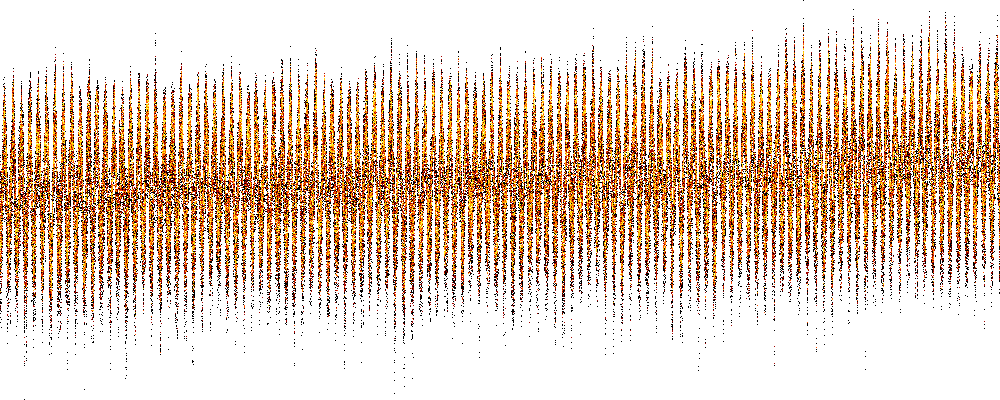

Datashader (Large): 0.20571 seconds


In [45]:
import datashader as ds
import datashader.transfer_functions as tf
import pandas as pd
import colorcet
import time
from IPython.display import display

# Prepare data
df = df_rcp85_large.copy()
df["date_num"] = df["date"].astype("int64") // 10**9

# Create canvas
start = time.time()
canvas = ds.Canvas(
    plot_width=1000,
    plot_height=400,
    x_range=(df["date_num"].min(), df["date_num"].max()),
    y_range=(df["value"].min(), df["value"].max())
)

# Aggregate
agg = canvas.points(df, "date_num", "value")

# Shade
img = tf.shade(agg, cmap=colorcet.fire, how="eq_hist")
img = tf.set_background(img, "white")

# Show image in notebook
display(img)

print("Datashader (Large):", round(time.time() - start, 5), "seconds")
